In [2]:
!pip install catboost

In [3]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import pylab
import missingno as msn
import folium
from folium import plugins
import branca.colormap as cm
from scipy.stats import pearsonr
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale 
from sklearn import model_selection
from sklearn.cross_decomposition import PLSRegression, PLSSVD
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
import statsmodels.api as sm
from sklearn import model_selection
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
from lightgbm import LGBMRegressor
from sklearn.experimental import enable_hist_gradient_boosting 
from sklearn.ensemble import HistGradientBoostingRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [4]:
data=pd.read_csv("house_data.csv")
df=data.copy()
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [5]:
print("Row : {}  \nColumn: {}".format(df.shape[0],df.shape[1]))

Row : 21613  
Column: 21


In [6]:
df.columns.values

array(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated',
       'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype=object)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [8]:
df['date'] = df.date.apply(pd.to_datetime)

In [9]:
df.date.head().to_frame()

,date
0,2014-10-13
1,2014-12-09
2,2015-02-25
3,2014-12-09
4,2015-02-18


In [10]:
df.date.min(),df.date.max()

(Timestamp('2014-05-02 00:00:00'), Timestamp('2015-05-27 00:00:00'))

In [11]:
df["date_year"]=df.date.dt.year
df["date_month"]=df.date.dt.month
#df["day_of_week"]=df.date.dt.dayofweek
#df["is_weekend"]=df.day_of_week.apply(lambda x:1 if x>4 else 0)

In [12]:
df=df.drop("date",axis=1)

In [13]:
df.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,...,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,...,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2


In [14]:
df[df.duplicated(subset=['id',"price"],keep=False)].sort_values(by="id")

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month
3950,1825069031,550000.0,4,1.75,2410,8447,2.0,0,3,4,...,350,1936,1980,98074,47.6499,-122.088,2520,14789,2014,8
3951,1825069031,550000.0,4,1.75,2410,8447,2.0,0,3,4,...,350,1936,1980,98074,47.6499,-122.088,2520,14789,2014,10
14982,6308000010,585000.0,3,2.50,2290,5089,2.0,0,0,3,...,0,2001,0,98006,47.5443,-122.172,2290,7984,2014,12
14983,6308000010,585000.0,3,2.50,2290,5089,2.0,0,0,3,...,0,2001,0,98006,47.5443,-122.172,2290,7984,2015,4
20053,8648900110,555000.0,3,2.50,1940,3211,2.0,0,0,3,...,0,2009,0,98027,47.5644,-122.093,1880,3078,2014,5
20054,8648900110,555000.0,3,2.50,1940,3211,2.0,0,0,3,...,0,2009,0,98027,47.5644,-122.093,1880,3078,2014,8


In [15]:
df[(df.price==0) & (df.price<0)]

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month


In [16]:
df.eq(0).sum().to_frame()

,0
id,0
price,0
bedrooms,13
bathrooms,10
sqft_living,0
sqft_lot,0
floors,0
waterfront,21450
view,19489
condition,0


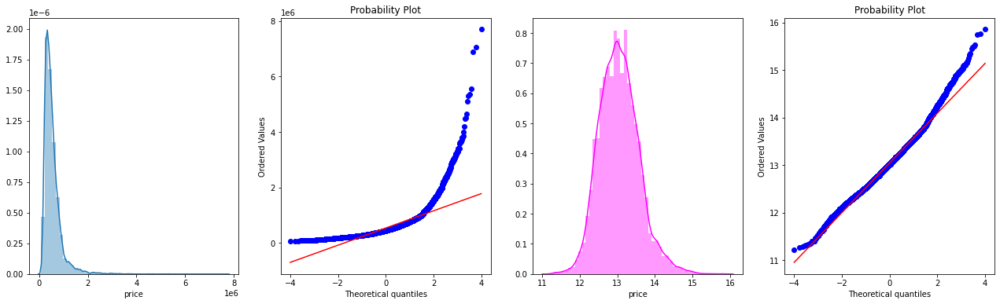

In [17]:
plt.figure(figsize=(22,6))

plt.subplot(141)
sns.distplot(df.price);

plt.subplot(142)
stats.probplot(df.price, dist="norm", plot=pylab) ;

plt.subplot(143)
sns.distplot(np.log(df.price),color="magenta");

plt.subplot(144)
stats.probplot(np.log(df.price), dist="norm", plot=pylab) ;

In [18]:
df=df.drop("id",axis=1)
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,...,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,...,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2


In [19]:
m = folium.Map([47 ,-122], zoom_start=5,width="%100",height="%100")
locations = list(zip(df.lat, df.long))
cluster = plugins.MarkerCluster(locations=locations,popups=df["price"].tolist())
m.add_child(cluster)
m

In [20]:
m = folium.Map(location=[47,-122],width="%100",height="%100")
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(m)
m

In [21]:
price=df[["lat","long","price"]]
min_price=df["price"].min()
max_price=df["price"].max()
min_price,max_price

(75000.0, 7700000.0)

In [22]:
pd.options.display.float_format = '{:.4f}'.format
df.price.describe().to_frame()

,price
count,21613.0000
mean,540088.1418
std,367127.1965
min,75000.0000
25%,321950.0000
50%,450000.0000
75%,645000.0000
max,7700000.0000


In [23]:
m = folium.Map(location=[47,-122],width="%100",height="%100")
colormap = cm.StepColormap(colors=['green','yellow','orange','red'] ,index=[min_price,321950,450000,645000,max_price],vmin= min_price,vmax=max_price)
for loc, p in zip(zip(price["lat"],price["long"]),price["price"]):
    folium.Circle(
        location=loc,
        radius=2,
        fill=True,
        color=colormap(p)).add_to(m)
m

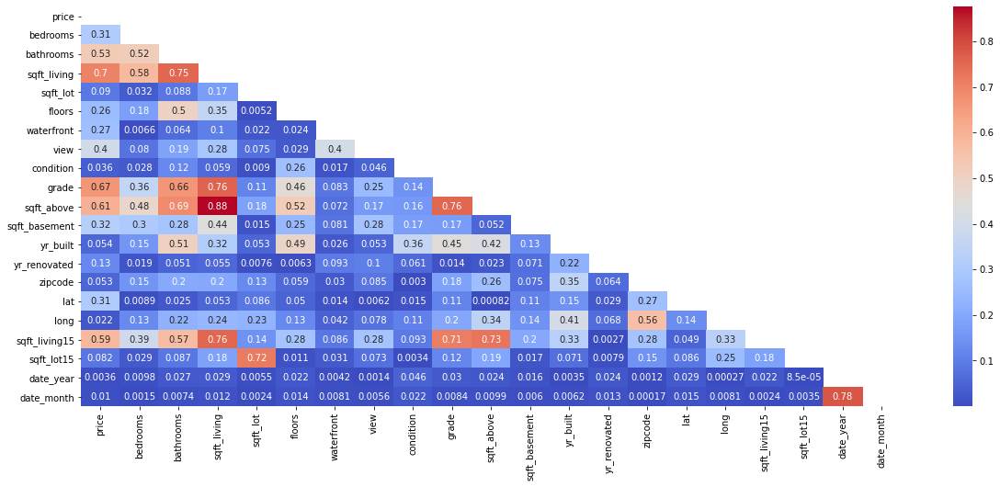

In [24]:
plt.figure(figsize=(20,8))
corr=df.corr().abs()
mask=np.zeros_like(corr,dtype=np.bool)
mask[np.triu_indices_from(mask)]=True
sns.heatmap(corr.abs(),annot=True,cmap="coolwarm",mask=mask);

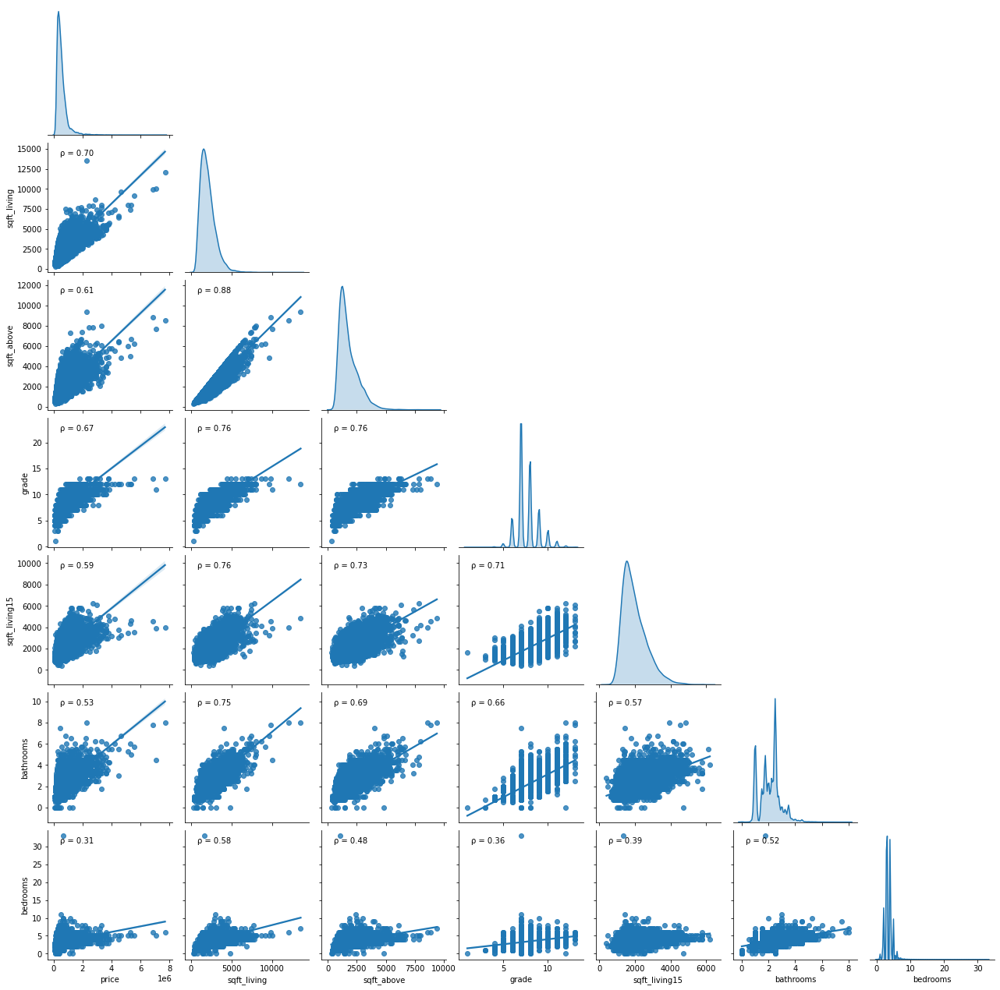

In [25]:
pairplot=sns.pairplot(df[["price","sqft_living","sqft_above","grade","sqft_living15","bathrooms","bedrooms"]],kind="reg",corner=True,diag_kind="kde");

def corrfunc(x,y, ax=None, **kws):
    r, _ = pearsonr(x, y)
    ax = ax or plt.gca()
    rho = '\u03C1'
    ax.annotate(f'{rho} = {r:.2f}', xy=(.1, .9), xycoords=ax.transAxes)
pairplot.map_lower(corrfunc)
plt.show()

In [26]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'date_year', 'date_month'],
      dtype='object')

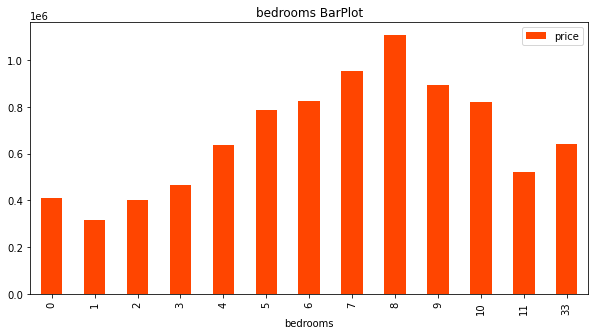

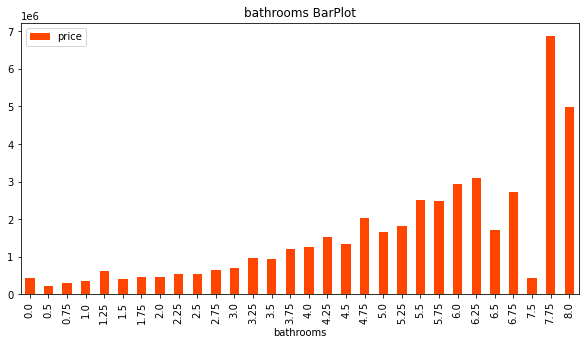

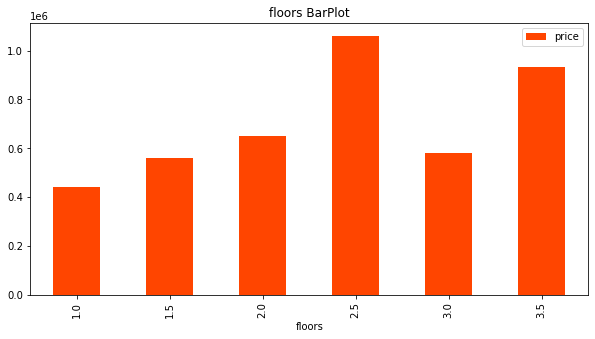

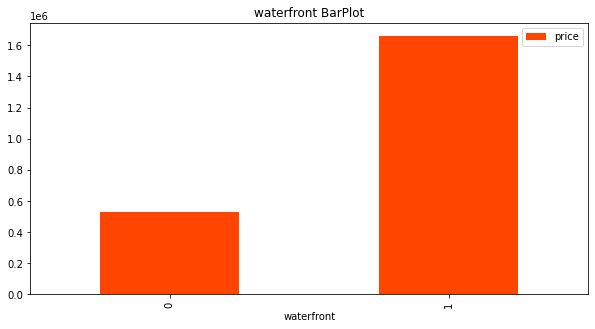

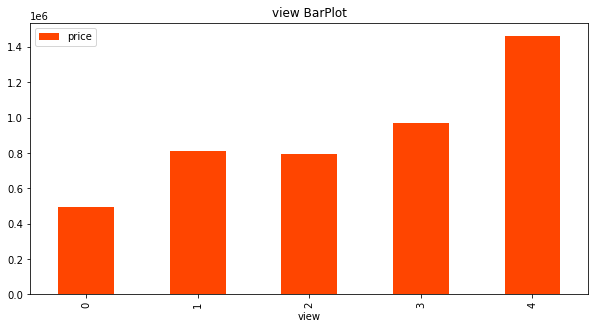

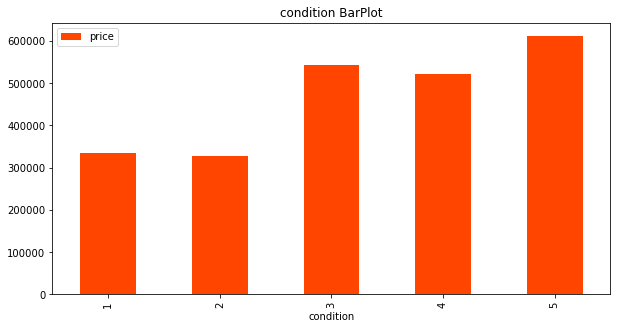

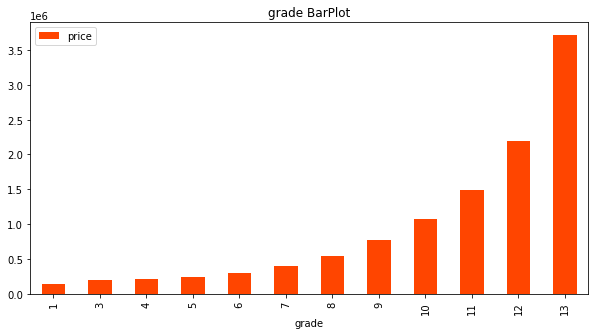

In [27]:
to_plot_list=["bedrooms","bathrooms","floors","waterfront","view","condition","grade"]
  

for i in to_plot_list:
    plt.figure(figsize=(10,5))
    df.groupby(i)["price"].mean().plot.bar(color="orangered");
    plt.legend()
    plt.title(i + " BarPlot")
    plt.show()

In [28]:
df.corr().abs()["price"].nlargest(15)

price           1.0000
sqft_living     0.7020
grade           0.6674
sqft_above      0.6056
sqft_living15   0.5854
bathrooms       0.5251
view            0.3973
sqft_basement   0.3238
bedrooms        0.3083
lat             0.3070
waterfront      0.2664
floors          0.2568
yr_renovated    0.1264
sqft_lot        0.0897
sqft_lot15      0.0824
Name: price, dtype: float64

No handles with labels found to put in legend.


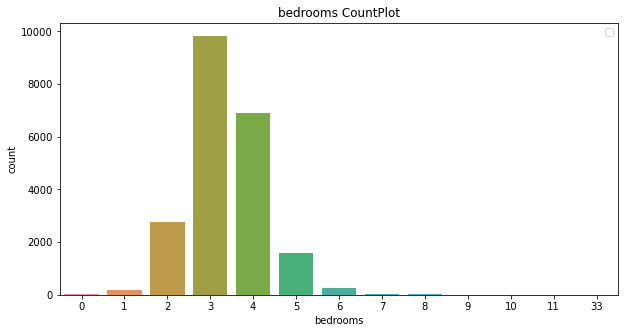

No handles with labels found to put in legend.


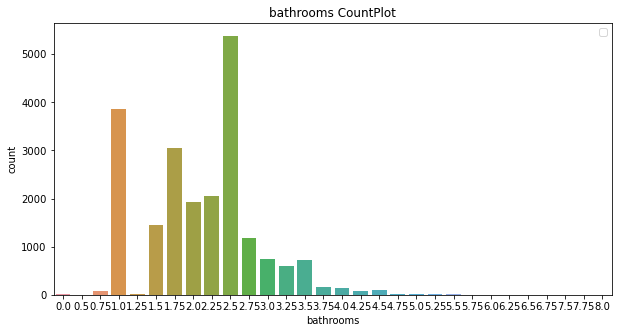

No handles with labels found to put in legend.


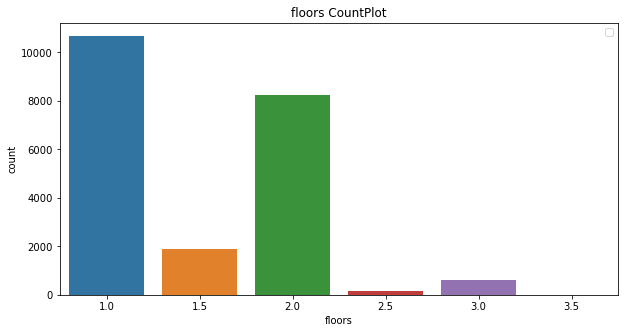

No handles with labels found to put in legend.


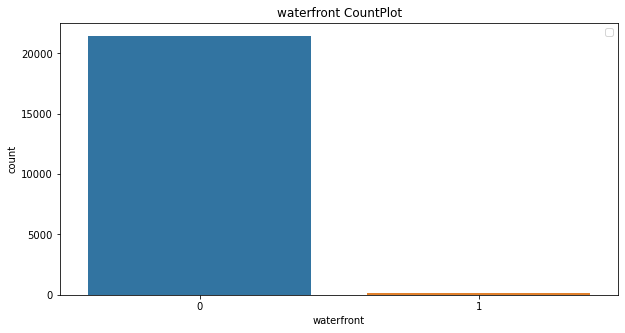

No handles with labels found to put in legend.


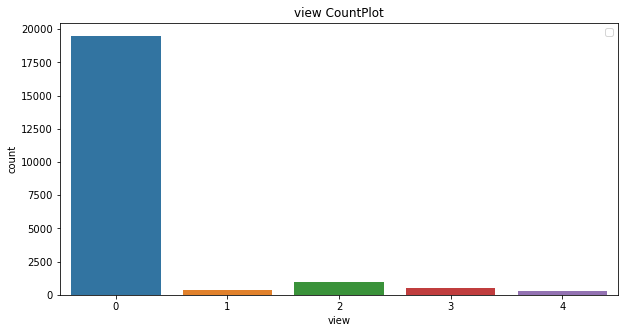

No handles with labels found to put in legend.


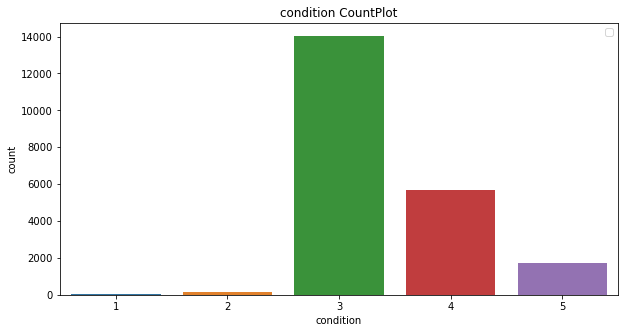

No handles with labels found to put in legend.


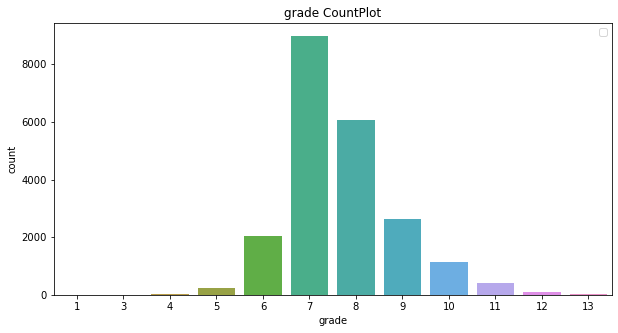

In [29]:
to_plot_list=["bedrooms","bathrooms","floors","waterfront","view","condition","grade"]
  

for i in to_plot_list:
    plt.figure(figsize=(10,5))
    sns.countplot(x=i,data=df);
    plt.legend()
    plt.title(i + " CountPlot")
    plt.show()

No handles with labels found to put in legend.


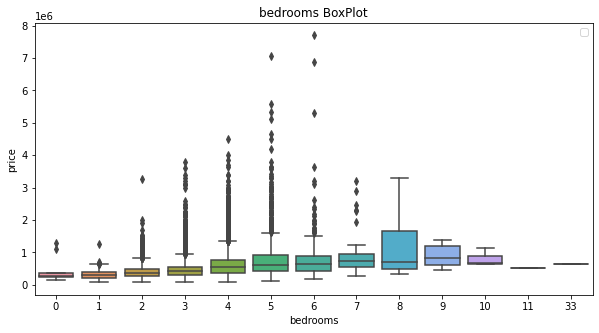

No handles with labels found to put in legend.


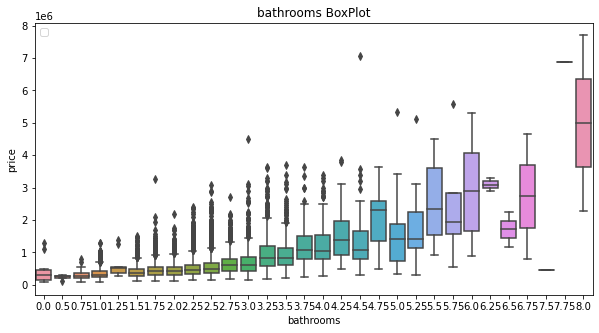

No handles with labels found to put in legend.


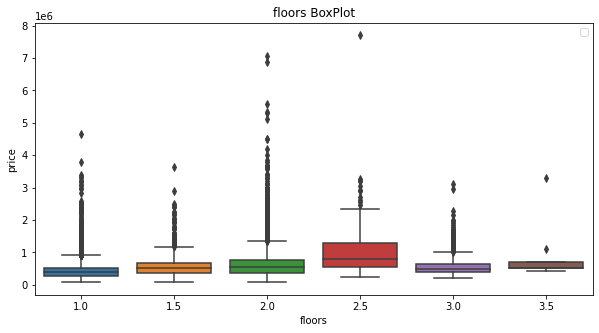

No handles with labels found to put in legend.


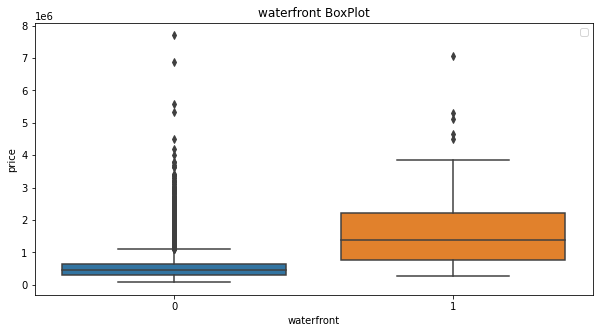

No handles with labels found to put in legend.


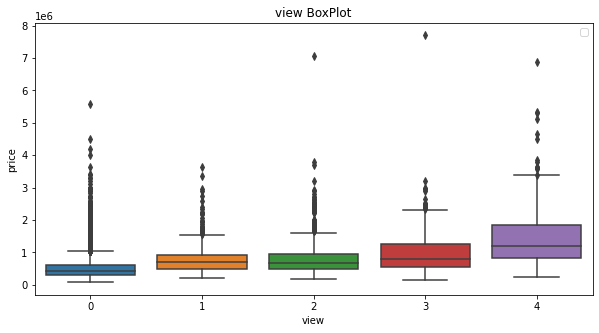

No handles with labels found to put in legend.


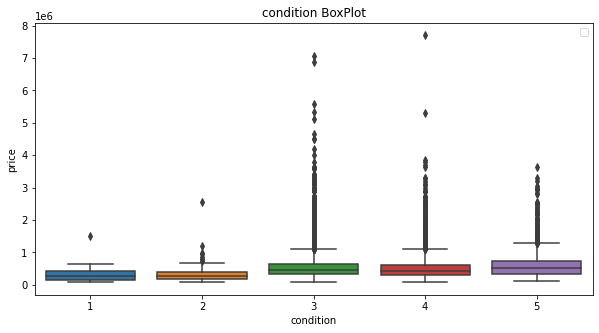

No handles with labels found to put in legend.


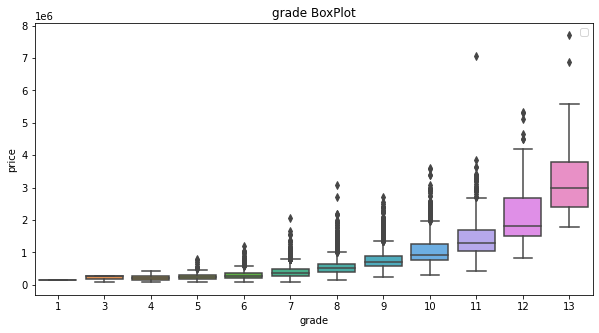

In [30]:
to_plot_list=["bedrooms","bathrooms","floors","waterfront","view","condition","grade"]
  

for i in to_plot_list:
    plt.figure(figsize=(10,5))
    sns.boxplot(x=i,y="price",data=df);
    plt.legend()
    plt.title(i + " BoxPlot")
    plt.show()

No handles with labels found to put in legend.


<Figure size 720x360 with 0 Axes>

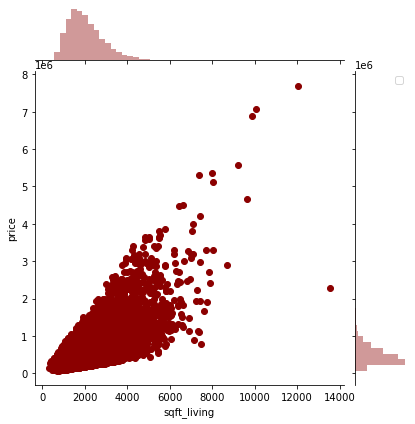

No handles with labels found to put in legend.


<Figure size 720x360 with 0 Axes>

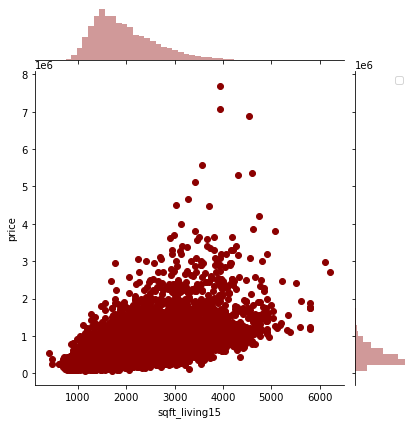

No handles with labels found to put in legend.


<Figure size 720x360 with 0 Axes>

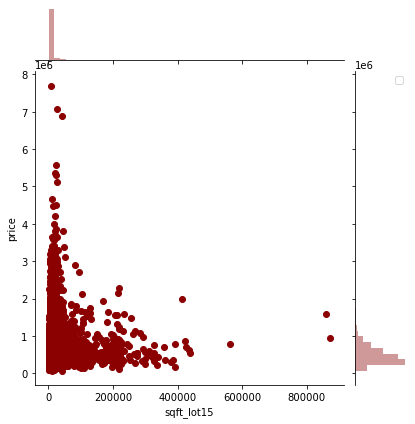

In [31]:
to_plot_list=["sqft_living","sqft_living15","sqft_lot15"]
  

for i in to_plot_list:
    plt.figure(figsize=(10,5));
    sns.jointplot(x=i,y="price",data=df,color="darkred");
    plt.legend();
    plt.show();

In [32]:
df[df["bedrooms"]>10]

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month
8757,520000.0000,11,3.0000,3000,4960,2.0000,0,0,3,7,...,600,1918,1999,98106,47.5560,-122.3630,1420,4960,2014,8
15870,640000.0000,33,1.7500,1620,6000,1.0000,0,0,5,7,...,580,1947,0,98103,47.6878,-122.3310,1330,4700,2014,6


In [33]:
df=df.drop(df[df["bedrooms"]>10].index)

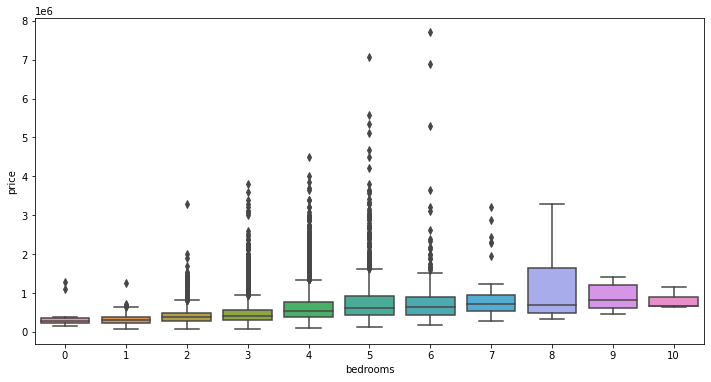

In [34]:
plt.figure(figsize=(12,6))
sns.boxplot(x="bedrooms",y="price",data=df);

In [35]:
df[df.sqft_lot15==df.sqft_lot].sample(10)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month
19444,872500.0000,4,2.0000,1990,6000,1.0000,0,0,3,9,...,730,1956,2015,98199,47.6515,-122.3970,1770,6000,2015,5
20941,336000.0000,3,2.5000,1260,1211,3.0000,0,0,3,8,...,0,2004,0,98103,47.6969,-122.3430,1270,1211,2014,9
14220,441000.0000,5,2.5000,2000,3600,1.0000,0,0,3,6,...,850,1987,0,98144,47.5971,-122.2950,1410,3600,2014,11
17643,700000.0000,3,1.7500,1350,4000,1.5000,0,0,4,7,...,0,1925,0,98103,47.6581,-122.3540,1880,4000,2015,4
21037,327000.0000,4,2.5000,2110,3825,2.0000,0,0,3,7,...,0,2013,0,98042,47.3590,-122.0820,1950,3825,2015,3
2339,1365000.0000,2,3.2500,2700,3444,3.0000,1,3,3,9,...,0,1990,0,98075,47.5684,-122.0600,2710,3444,2014,7
3707,201700.0000,3,1.0000,1010,9576,1.0000,0,0,4,7,...,0,1967,0,98001,47.2956,-122.2720,1540,9576,2015,3
7635,265000.0000,2,1.0000,940,9458,1.0000,0,0,3,6,...,0,1948,0,98155,47.7523,-122.3110,1450,9458,2015,3
1188,343000.0000,2,1.0000,1230,7560,1.0000,0,0,3,7,...,0,1961,0,98133,47.7298,-122.3400,1270,7560,2014,10
15173,805000.0000,3,2.2500,2860,11250,1.0000,0,1,5,8,...,570,1956,0,98166,47.4534,-122.3720,2030,11250,2014,8


In [36]:
df[df["bathrooms"]>=7][["price","bathrooms","bedrooms","sqft_living"]]

,price,bathrooms,bedrooms,sqft_living
7252,7700000.0000,8.0000,6,12050
8546,450000.0000,7.5000,9,4050
9254,6885000.0000,7.7500,6,9890
12777,2280000.0000,8.0000,7,13540


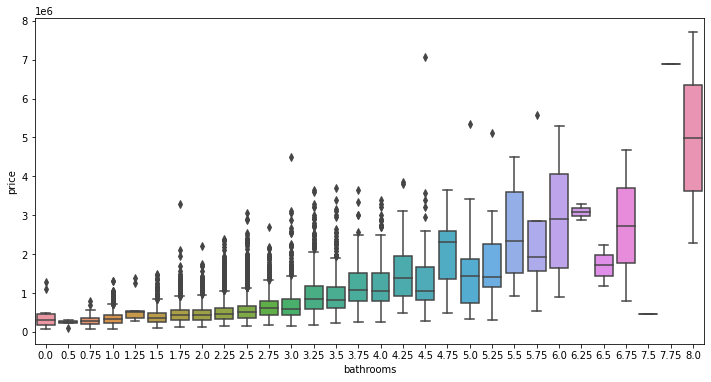

In [37]:
plt.figure(figsize=(12,6))
sns.boxplot(x="bathrooms",y="price",data=df);

In [38]:
df["bathrooms"] = df['bathrooms'].round(0).astype(int)  #float bathroom?????

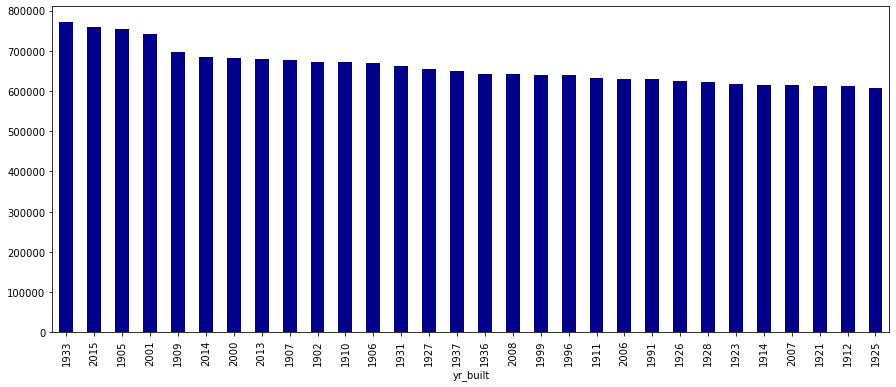

In [39]:
plt.figure(figsize=(15,6))
df.groupby("yr_built")["price"].mean().nlargest(30).plot.bar(color="darkblue");

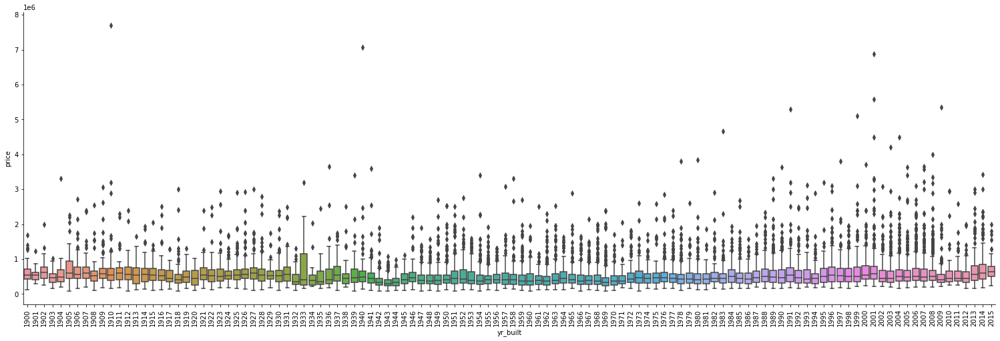

In [40]:
sns.catplot(x="yr_built", y = "price", data=df,size= 7, aspect = 3, kind="box" );
plt.xticks(rotation=90);

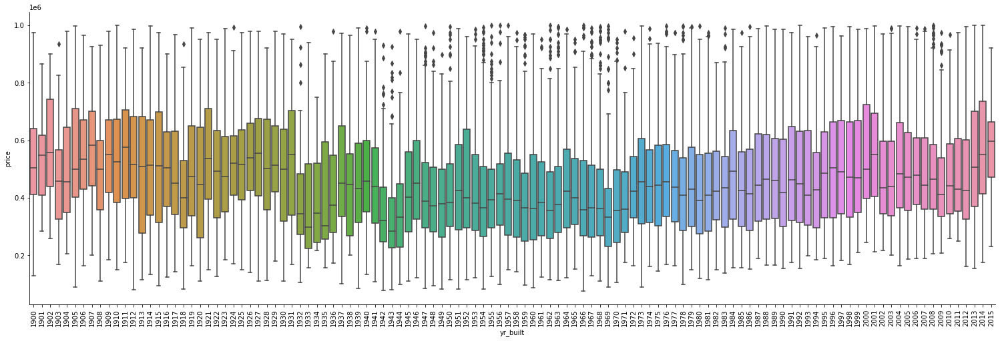

In [41]:

sns.catplot(x="yr_built", y = "price", data=df[df.price<1000000],size= 7, aspect = 3, kind="box" );
plt.xticks(rotation=90);

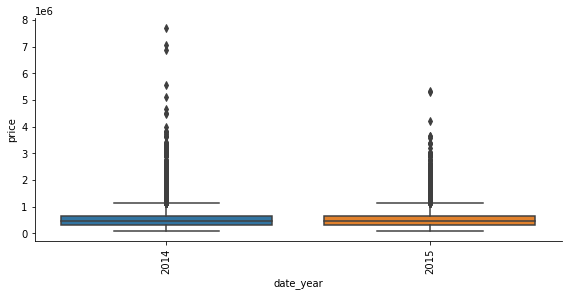

In [42]:
sns.catplot(x="date_year", y = "price", data=df,size= 4, aspect = 2, kind="box" );
plt.xticks(rotation=90);

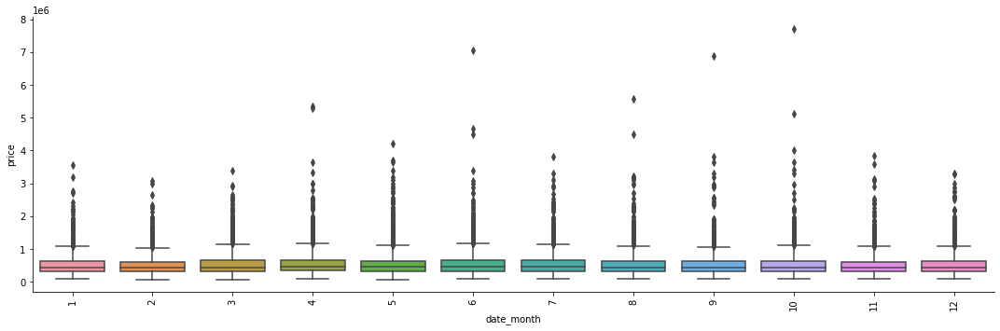

In [43]:
sns.catplot(x="date_month", y = "price", data=df,size= 5, aspect = 3, kind="box" );
plt.xticks(rotation=90);

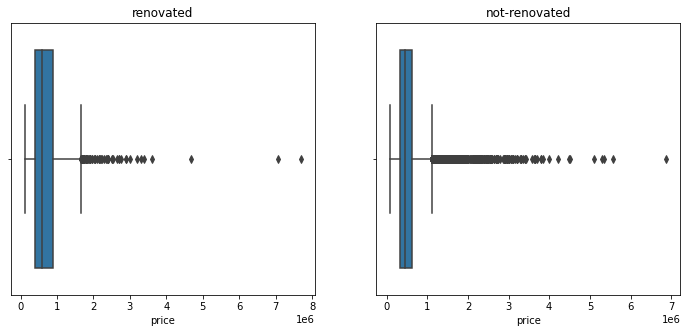

In [44]:
plt.figure(figsize=(12,5))
plt.subplot(121)
sns.boxplot(df[df["yr_renovated"]>0]["price"]);
plt.title("renovated")
plt.subplot(122)
sns.boxplot(df[df["yr_renovated"]==0]["price"]);
plt.title("not-renovated");

In [45]:
df[(df["date_year"]-df["yr_built"])<0][["date_year","yr_built"]] # they could be sold before being build or there is a mistake,I dont know

,date_year,yr_built
1763,2014,2015
2687,2014,2015
7526,2014,2015
8039,2014,2015
14489,2014,2015
17098,2014,2015
19805,2014,2015
20770,2014,2015
20852,2014,2015
20963,2014,2015


In [46]:
df=df.drop(df[(df["date_year"]-df["yr_built"])<0].index)

In [47]:
df_new=df.copy()

In [48]:
df_new["is_renovated"]=df_new["yr_renovated"].apply( lambda x:1 if x>0 else 0)

In [49]:
df_new.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month,is_renovated
0,221900.0000,3,1,1180,5650,1.0000,0,0,3,7,...,1955,0,98178,47.5112,-122.2570,1340,5650,2014,10,0
1,538000.0000,3,2,2570,7242,2.0000,0,0,3,7,...,1951,1991,98125,47.7210,-122.3190,1690,7639,2014,12,1
2,180000.0000,2,1,770,10000,1.0000,0,0,3,6,...,1933,0,98028,47.7379,-122.2330,2720,8062,2015,2,0
3,604000.0000,4,3,1960,5000,1.0000,0,0,5,7,...,1965,0,98136,47.5208,-122.3930,1360,5000,2014,12,0
4,510000.0000,3,2,1680,8080,1.0000,0,0,3,8,...,1987,0,98074,47.6168,-122.0450,1800,7503,2015,2,0


In [50]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'date_year', 'date_month'],
      dtype='object')

In [51]:
df[["sqft_living","sqft_lot","sqft_above","sqft_basement","sqft_living15","sqft_lot15"]].sample(7)
# sqft_living - sqft_above=sqft_basement


,sqft_living,sqft_lot,sqft_above,sqft_basement,sqft_living15,sqft_lot15
5609,1610,11201,1020,590,1610,9000
8611,1995,115670,1995,0,2142,29375
747,2170,4912,2170,0,2010,4395
13805,1800,9236,1800,0,1730,5701
5102,2010,9725,2010,0,1850,6858
3720,3360,84506,2040,1320,2190,43124
12395,1780,10260,1780,0,2360,10080


In [52]:
df[df["sqft_living"]==df["sqft_above"]][["sqft_living","sqft_above","sqft_lot","sqft_basement","sqft_living15","sqft_lot15"]]

,sqft_living,sqft_above,sqft_lot,sqft_basement,sqft_living15,sqft_lot15
0,1180,1180,5650,0,1340,5650
2,770,770,10000,0,2720,8062
4,1680,1680,8080,0,1800,7503
6,1715,1715,6819,0,2238,6819
7,1060,1060,9711,0,1650,9711
...,...,...,...,...,...,...
21608,1530,1530,1131,0,1530,1509
21609,2310,2310,5813,0,1830,7200
21610,1020,1020,1350,0,1020,2007
21611,1600,1600,2388,0,1410,1287


In [53]:
df_new["total_room"]=df_new["bedrooms"]+df_new["bathrooms"]

In [54]:
#df_new["sqft_per_room"]=pd.Series(df_new["sqft_living"]/df_new["total_room"],index=df_new.index)

In [55]:
df_new.corr()["price"].nlargest(15)

price           1.0000
sqft_living     0.7023
grade           0.6678
sqft_above      0.6057
sqft_living15   0.5854
bathrooms       0.5191
total_room      0.4706
view            0.3974
sqft_basement   0.3238
bedrooms        0.3161
lat             0.3071
waterfront      0.2664
floors          0.2572
yr_renovated    0.1265
is_renovated    0.1262
Name: price, dtype: float64

In [56]:
df_new.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date_year,date_month,is_renovated,total_room
0,221900.0000,3,1,1180,5650,1.0000,0,0,3,7,...,0,98178,47.5112,-122.2570,1340,5650,2014,10,0,4
1,538000.0000,3,2,2570,7242,2.0000,0,0,3,7,...,1991,98125,47.7210,-122.3190,1690,7639,2014,12,1,5
2,180000.0000,2,1,770,10000,1.0000,0,0,3,6,...,0,98028,47.7379,-122.2330,2720,8062,2015,2,0,3
3,604000.0000,4,3,1960,5000,1.0000,0,0,5,7,...,0,98136,47.5208,-122.3930,1360,5000,2014,12,0,7
4,510000.0000,3,2,1680,8080,1.0000,0,0,3,8,...,0,98074,47.6168,-122.0450,1800,7503,2015,2,0,5


In [57]:
X=df_new.drop(["lat","long","price","is_renovated","sqft_above","sqft_basement","bedrooms","bathrooms"],axis=1)

y=np.log(df_new["price"])
#y=df_new["price"]

In [58]:
X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    y, 
                                                    test_size=0.30, 
                                                    random_state=42)

## GRADIENT BOOSTING REGRESSOR

In [59]:
def adjustedR2(r2,n,k):
    return r2-(k-1)/(n-k)*(1-r2)

In [60]:
gbm_model = GradientBoostingRegressor(max_depth=7,random_state=42)
gbm_model.fit(X_train, y_train)
y_pred = gbm_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

0.1857273920210512

In [61]:
r2_score(y_test,y_pred)

0.8783932165056312

In [62]:
y_tr_pred=gbm_model.predict(X_train)

In [63]:
r2_score(y_train,y_tr_pred)

0.9336461589158375

In [64]:
adjustedR2(r2_score(y_test,y_pred),df_new.shape[0],df_new.shape[1])

0.878269219970737

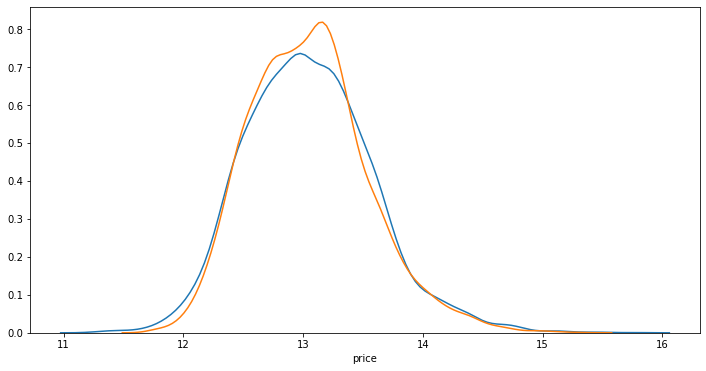

In [65]:
plt.figure(figsize=(12,6))
ax1=sns.distplot(y_test,hist=False);
sns.distplot(y_pred,ax=ax1,hist=False);

Text(0.5, 0, 'İmportance LEevels')

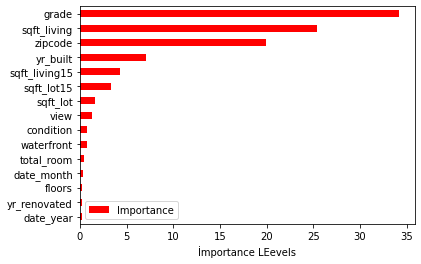

In [66]:
Importance = pd.DataFrame({"Importance": gbm_model.feature_importances_*100},
                         index = X_train.columns)
Importance.sort_values(by = "Importance", 
                       axis = 0, 
                       ascending = True).plot(kind ="barh", color = "r")

plt.xlabel("İmportance LEevels")

## XGBOOST REGRESSOR

In [67]:
DM_train = xgb.DMatrix(data = X_train, label = y_train)
DM_test = xgb.DMatrix(data = X_test, label = y_test)
xgb_model = XGBRegressor(max_depth=4,random_state=42).fit(X_train, y_train)
y_pred = xgb_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

[19:54:26] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


0.205531973902566

In [68]:
y_tr_pred=xgb_model.predict(X_train)

In [69]:
r2_score(y_train,y_tr_pred)

0.8576053286974137

In [70]:
adjustedR2(r2_score(y_test,y_pred),df_new.shape[0],df_new.shape[1])

0.8509241582001333

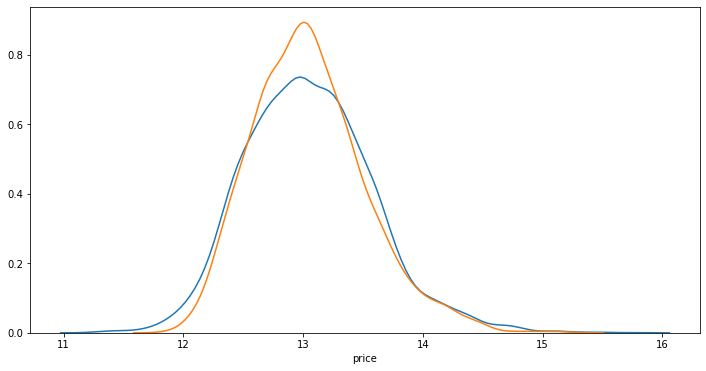

In [71]:
plt.figure(figsize=(12,6))
ax1=sns.distplot(y_test,hist=False);
sns.distplot(y_pred,ax=ax1,hist=False);

Text(0.5, 0, 'İmportance LEevels')

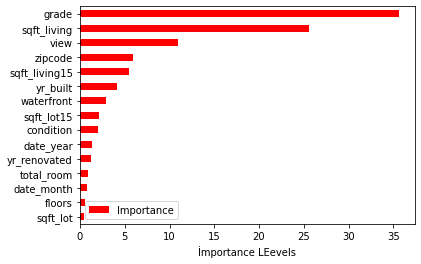

In [72]:
Importance = pd.DataFrame({"Importance": xgb_model.feature_importances_*100},
                         index = X_train.columns)
Importance.sort_values(by = "Importance", 
                       axis = 0, 
                       ascending = True).plot(kind ="barh", color = "r")

plt.xlabel("İmportance LEevels")

## LİGHTGBM REGRESSOR

In [73]:
lgbm = LGBMRegressor()
lgbm_model = lgbm.fit(X_train, y_train)
y_pred = lgbm_model.predict(X_test, 
                            num_iteration = lgbm_model.best_iteration_)
np.sqrt(mean_squared_error(y_test, y_pred))

0.1808231106050352

In [74]:
y_tr_pred=xgb_model.predict(X_train)

In [75]:
r2_score(y_train,y_tr_pred)

0.8576053286974137

In [76]:
r2_score(y_test,y_pred)

0.884730674339911

In [77]:
adjustedR2(r2_score(y_test,y_pred),df_new.shape[0],df_new.shape[1])

0.8846131398031793

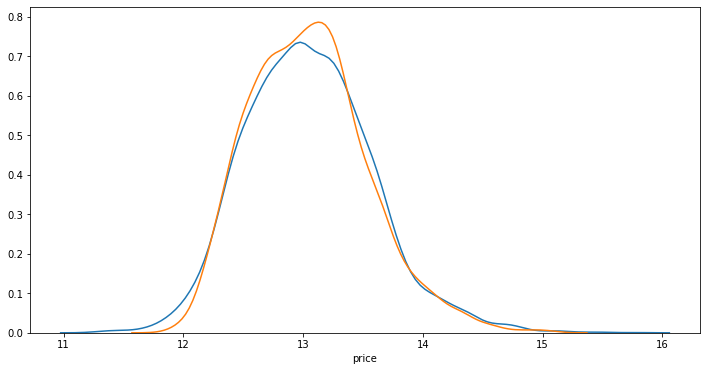

In [78]:
plt.figure(figsize=(12,6))
ax1=sns.distplot(y_test,hist=False);
sns.distplot(y_pred,ax=ax1,hist=False);

Text(0.5, 0, 'İmportance LEevels')

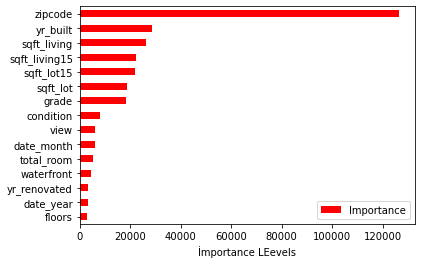

In [79]:
Importance = pd.DataFrame({"Importance":lgbm_model.feature_importances_*100},
                         index = X_train.columns)
Importance.sort_values(by = "Importance", 
                       axis = 0, 
                       ascending = True).plot(kind ="barh", color = "r")

plt.xlabel("İmportance LEevels")

## HISTOGRAM BASED BOOSTING REGRESSOR

In [80]:
est = HistGradientBoostingRegressor(random_state=42)
hist_model=est.fit(X_train, y_train)
y_pred=hist_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

0.18146167801391028

In [81]:
y_tr_pred=xgb_model.predict(X_train)
r2_score(y_train,y_tr_pred)

0.8576053286974137

In [82]:
r2_score(y_test,y_pred)

0.8839151015469993

In [83]:
adjustedR2(r2_score(y_test,y_pred),df_new.shape[0],df_new.shape[1])

0.8837967354102748

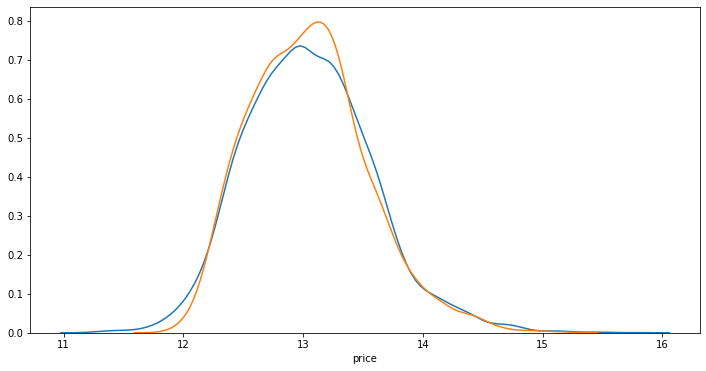

In [84]:
plt.figure(figsize=(12,6))
ax1=sns.distplot(y_test,hist=False);
sns.distplot(y_pred,ax=ax1,hist=False);

## CATBOOST REGRESSOR

In [85]:
catb = CatBoostRegressor(random_state=42)
catb_model = catb.fit(X_train, y_train)
y_pred = catb_model.predict(X_test)


Learning rate set to 0.063293
0:	learn: 0.5065204	total: 60.8ms	remaining: 1m
1:	learn: 0.4913218	total: 65.1ms	remaining: 32.5s
2:	learn: 0.4755124	total: 69.9ms	remaining: 23.2s
3:	learn: 0.4617115	total: 74ms	remaining: 18.4s
4:	learn: 0.4483797	total: 82.7ms	remaining: 16.4s
5:	learn: 0.4361538	total: 87.2ms	remaining: 14.5s
6:	learn: 0.4256625	total: 91.3ms	remaining: 12.9s
7:	learn: 0.4159001	total: 96.3ms	remaining: 11.9s
8:	learn: 0.4058416	total: 101ms	remaining: 11.1s
9:	learn: 0.3958247	total: 105ms	remaining: 10.4s
10:	learn: 0.3874552	total: 109ms	remaining: 9.76s
11:	learn: 0.3801983	total: 113ms	remaining: 9.32s
12:	learn: 0.3728171	total: 117ms	remaining: 8.92s
13:	learn: 0.3655682	total: 122ms	remaining: 8.58s
14:	learn: 0.3594023	total: 127ms	remaining: 8.32s
15:	learn: 0.3531161	total: 137ms	remaining: 8.43s
16:	learn: 0.3480323	total: 142ms	remaining: 8.2s
17:	learn: 0.3425713	total: 146ms	remaining: 7.95s
18:	learn: 0.3381651	total: 150ms	remaining: 7.73s
19:	learn

182:	learn: 0.2065937	total: 863ms	remaining: 3.85s
183:	learn: 0.2058853	total: 867ms	remaining: 3.85s
184:	learn: 0.2055321	total: 872ms	remaining: 3.84s
185:	learn: 0.2047219	total: 876ms	remaining: 3.83s
186:	learn: 0.2046058	total: 881ms	remaining: 3.83s
187:	learn: 0.2043397	total: 885ms	remaining: 3.82s
188:	learn: 0.2041871	total: 891ms	remaining: 3.82s
189:	learn: 0.2038401	total: 895ms	remaining: 3.81s
190:	learn: 0.2037003	total: 900ms	remaining: 3.81s
191:	learn: 0.2035854	total: 904ms	remaining: 3.8s
192:	learn: 0.2034214	total: 908ms	remaining: 3.8s
193:	learn: 0.2030890	total: 914ms	remaining: 3.8s
194:	learn: 0.2027617	total: 919ms	remaining: 3.79s
195:	learn: 0.2021823	total: 927ms	remaining: 3.8s
196:	learn: 0.2020375	total: 931ms	remaining: 3.79s
197:	learn: 0.2017979	total: 937ms	remaining: 3.8s
198:	learn: 0.2015571	total: 941ms	remaining: 3.79s
199:	learn: 0.2014584	total: 945ms	remaining: 3.78s
200:	learn: 0.2011219	total: 949ms	remaining: 3.77s
201:	learn: 0.201

345:	learn: 0.1784888	total: 1.72s	remaining: 3.25s
346:	learn: 0.1783675	total: 1.72s	remaining: 3.24s
347:	learn: 0.1783056	total: 1.73s	remaining: 3.23s
348:	learn: 0.1781735	total: 1.73s	remaining: 3.23s
349:	learn: 0.1780878	total: 1.74s	remaining: 3.23s
350:	learn: 0.1780176	total: 1.75s	remaining: 3.23s
351:	learn: 0.1779266	total: 1.75s	remaining: 3.22s
352:	learn: 0.1778387	total: 1.75s	remaining: 3.21s
353:	learn: 0.1776096	total: 1.76s	remaining: 3.21s
354:	learn: 0.1774618	total: 1.76s	remaining: 3.2s
355:	learn: 0.1773332	total: 1.77s	remaining: 3.2s
356:	learn: 0.1771951	total: 1.77s	remaining: 3.19s
357:	learn: 0.1771301	total: 1.79s	remaining: 3.2s
358:	learn: 0.1770255	total: 1.79s	remaining: 3.2s
359:	learn: 0.1769310	total: 1.79s	remaining: 3.19s
360:	learn: 0.1768458	total: 1.8s	remaining: 3.18s
361:	learn: 0.1767569	total: 1.8s	remaining: 3.18s
362:	learn: 0.1766822	total: 1.81s	remaining: 3.17s
363:	learn: 0.1766234	total: 1.81s	remaining: 3.17s
364:	learn: 0.1765

534:	learn: 0.1638711	total: 2.58s	remaining: 2.24s
535:	learn: 0.1637977	total: 2.58s	remaining: 2.23s
536:	learn: 0.1637191	total: 2.59s	remaining: 2.23s
537:	learn: 0.1637000	total: 2.59s	remaining: 2.22s
538:	learn: 0.1636472	total: 2.6s	remaining: 2.22s
539:	learn: 0.1635847	total: 2.6s	remaining: 2.21s
540:	learn: 0.1635066	total: 2.6s	remaining: 2.21s
541:	learn: 0.1634582	total: 2.61s	remaining: 2.2s
542:	learn: 0.1633927	total: 2.62s	remaining: 2.2s
543:	learn: 0.1633482	total: 2.62s	remaining: 2.2s
544:	learn: 0.1632894	total: 2.62s	remaining: 2.19s
545:	learn: 0.1632431	total: 2.63s	remaining: 2.19s
546:	learn: 0.1632011	total: 2.63s	remaining: 2.18s
547:	learn: 0.1631419	total: 2.64s	remaining: 2.17s
548:	learn: 0.1630950	total: 2.64s	remaining: 2.17s
549:	learn: 0.1630541	total: 2.64s	remaining: 2.16s
550:	learn: 0.1629722	total: 2.65s	remaining: 2.16s
551:	learn: 0.1629228	total: 2.65s	remaining: 2.15s
552:	learn: 0.1628645	total: 2.66s	remaining: 2.15s
553:	learn: 0.1628

728:	learn: 0.1545056	total: 3.43s	remaining: 1.28s
729:	learn: 0.1544545	total: 3.44s	remaining: 1.27s
730:	learn: 0.1544164	total: 3.44s	remaining: 1.27s
731:	learn: 0.1543645	total: 3.45s	remaining: 1.26s
732:	learn: 0.1542680	total: 3.45s	remaining: 1.26s
733:	learn: 0.1542343	total: 3.45s	remaining: 1.25s
734:	learn: 0.1541881	total: 3.46s	remaining: 1.25s
735:	learn: 0.1541684	total: 3.46s	remaining: 1.24s
736:	learn: 0.1541057	total: 3.47s	remaining: 1.24s
737:	learn: 0.1540319	total: 3.47s	remaining: 1.23s
738:	learn: 0.1539978	total: 3.48s	remaining: 1.23s
739:	learn: 0.1539599	total: 3.48s	remaining: 1.22s
740:	learn: 0.1539215	total: 3.49s	remaining: 1.22s
741:	learn: 0.1538897	total: 3.49s	remaining: 1.21s
742:	learn: 0.1538683	total: 3.5s	remaining: 1.21s
743:	learn: 0.1538279	total: 3.5s	remaining: 1.2s
744:	learn: 0.1537953	total: 3.5s	remaining: 1.2s
745:	learn: 0.1537391	total: 3.51s	remaining: 1.19s
746:	learn: 0.1537107	total: 3.51s	remaining: 1.19s
747:	learn: 0.153

890:	learn: 0.1482284	total: 4.12s	remaining: 504ms
891:	learn: 0.1482129	total: 4.12s	remaining: 499ms
892:	learn: 0.1481722	total: 4.13s	remaining: 495ms
893:	learn: 0.1481413	total: 4.13s	remaining: 490ms
894:	learn: 0.1481035	total: 4.14s	remaining: 486ms
895:	learn: 0.1480762	total: 4.14s	remaining: 481ms
896:	learn: 0.1480606	total: 4.15s	remaining: 476ms
897:	learn: 0.1480322	total: 4.15s	remaining: 472ms
898:	learn: 0.1480037	total: 4.15s	remaining: 467ms
899:	learn: 0.1479654	total: 4.16s	remaining: 462ms
900:	learn: 0.1479391	total: 4.16s	remaining: 457ms
901:	learn: 0.1479305	total: 4.17s	remaining: 453ms
902:	learn: 0.1478999	total: 4.17s	remaining: 448ms
903:	learn: 0.1478699	total: 4.18s	remaining: 444ms
904:	learn: 0.1478191	total: 4.18s	remaining: 439ms
905:	learn: 0.1477924	total: 4.19s	remaining: 434ms
906:	learn: 0.1477544	total: 4.19s	remaining: 430ms
907:	learn: 0.1477135	total: 4.2s	remaining: 425ms
908:	learn: 0.1476828	total: 4.2s	remaining: 420ms
909:	learn: 0.

In [86]:
np.sqrt(mean_squared_error(y_test, y_pred))

0.17193322961452664

In [87]:
y_tr_pred=xgb_model.predict(X_train)
r2_score(y_train,y_tr_pred)

0.8576053286974137

In [88]:
r2_score(y_test,y_pred)

0.8957861302258504

In [89]:
adjustedR2(r2_score(y_test,y_pred),df_new.shape[0],df_new.shape[1])

0.8956798684009045

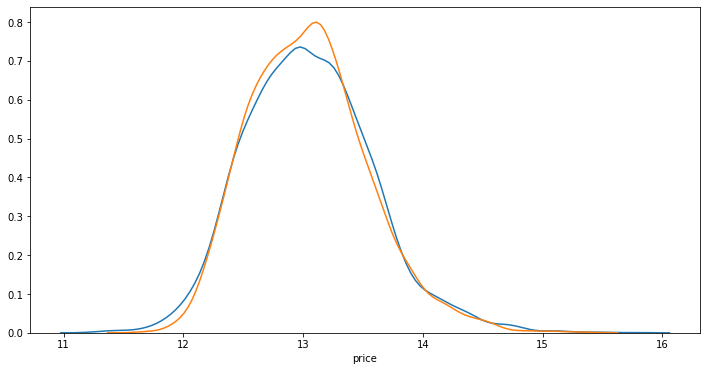

In [90]:
plt.figure(figsize=(12,6))
ax1=sns.distplot(y_test,hist=False);
sns.distplot(y_pred,ax=ax1,hist=False);